In [ ]:
import numpy as np
import os
import cv2
from google.colab.patches import cv2_imshow
from google.colab import files
import shutil

In [ ]:
!wget https://motchallenge.net/data/MOT16.zip
!unzip -q MOT16.zip

--2025-05-29 18:16:11--  https://motchallenge.net/data/MOT16.zip
Resolving motchallenge.net (motchallenge.net)... 131.159.19.34, 2a09:80c0:18::1034
Connecting to motchallenge.net (motchallenge.net)|131.159.19.34|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1954509127 (1.8G) [application/zip]
Saving to: ‘MOT16.zip’

MOT16.zip           100%[===================>]   1.82G  13.8MB/s    in 2m 12s  

2025-05-29 18:18:25 (14.1 MB/s) - ‘MOT16.zip’ saved [1954509127/1954509127]



In [ ]:
os.makedirs('videos', exist_ok=True)

uploaded = files.upload()

for fn in uploaded.keys():
    shutil.move(fn, f'videos/{fn}')

Saving Cars.mp4 to Cars.mp4


In [ ]:
def initialize_subtractors():
    return {
        'MOG': cv2.bgsegm.createBackgroundSubtractorMOG(history=200,
                                                        nmixtures=5),
        'MOG2': cv2.createBackgroundSubtractorMOG2(history=500,
                                                   detectShadows=False),
        'KNN': cv2.createBackgroundSubtractorKNN(history=500,
                                                 dist2Threshold=400)
    }

In [ ]:
def apply_morphological_filters(fgmask):
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))

    filtered = cv2.morphologyEx(fgmask, cv2.MORPH_OPEN, kernel,
                                iterations=1)

    filtered = cv2.morphologyEx(filtered, cv2.MORPH_CLOSE, kernel,
                                iterations=2)

    filtered = cv2.dilate(filtered, kernel, iterations=1)

    return filtered

In [ ]:
def detect_objects(fgmask, min_area=200, max_area=50000, min_aspect=0.1,
                   max_aspect=4.0):
    contours, _ = cv2.findContours(fgmask, cv2.RETR_EXTERNAL,
                                   cv2.CHAIN_APPROX_SIMPLE)
    valid_boxes = []

    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < min_area or area > max_area:
            continue

        rect = cv2.minAreaRect(cnt)
        box = cv2.boxPoints(rect)
        box = np.intp(box)

        width = rect[1][0]
        height = rect[1][1]
        aspect_ratio = max(width, height) / min(width, height)

        if aspect_ratio < min_aspect or aspect_ratio > max_aspect:
            continue

        valid_boxes.append(box)

    return valid_boxes

In [ ]:
def process_video(input_path, output_path='motion_detection_output.mp4'):
    cap = cv2.VideoCapture(input_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)

    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    subtractors = initialize_subtractors()

    colors = {
        'MOG': (0, 255, 255),   # Yellow
        'MOG2': (0, 255, 0),    # Green
        'KNN': (255, 0, 0)      # Blue
    }

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        result_frame = frame.copy()

        for method, subtractor in subtractors.items():
            fgmask = subtractor.apply(frame)

            fgmask = apply_morphological_filters(fgmask)

            boxes = detect_objects(fgmask)

            for box in boxes:
                cv2.drawContours(result_frame, [box], 0, colors[method], 2)
                cv2.putText(result_frame, method, (box[0][0], box[0][1]-10),
                          cv2.FONT_HERSHEY_SIMPLEX, 0.5, colors[method], 1)

        out.write(result_frame)

        cv2_imshow(cv2.resize(result_frame, (0,0), fx=0.5, fy=0.5))
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    out.release()
    cv2.destroyAllWindows()

    if os.path.exists(output_path):
        files.download(output_path)
    else:
        print("Video creation failed")

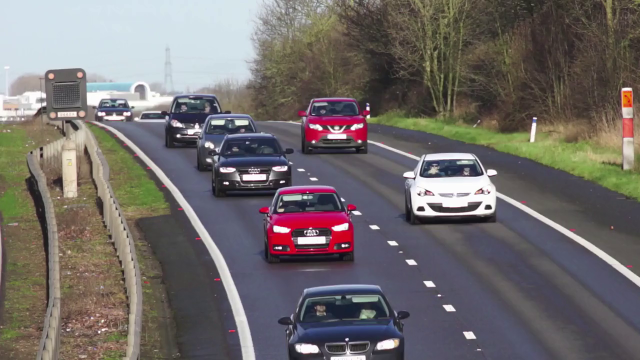

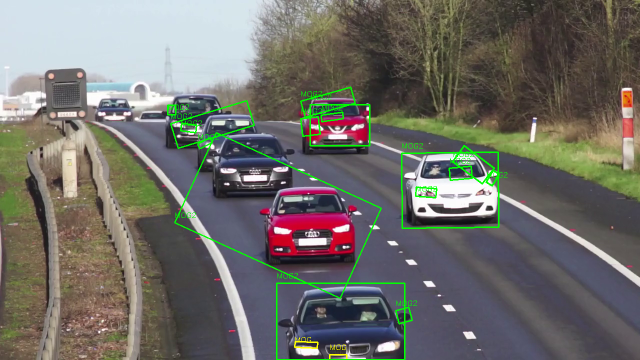

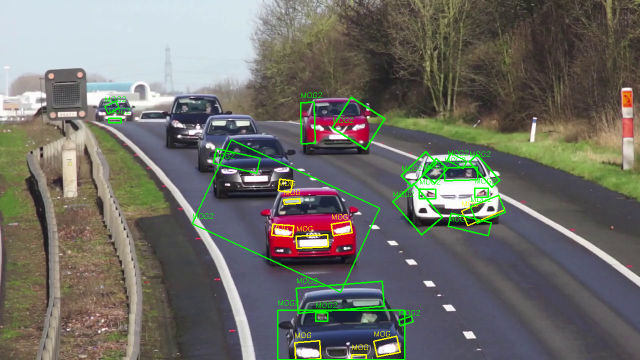

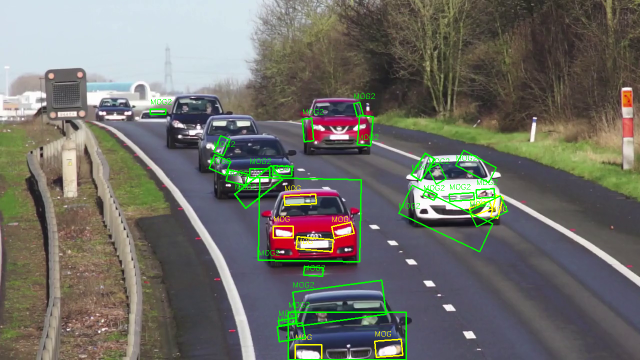

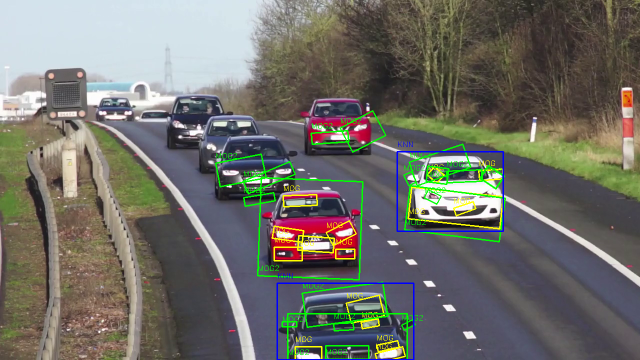

...

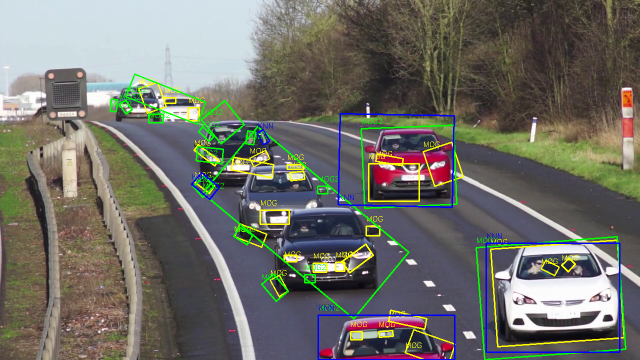

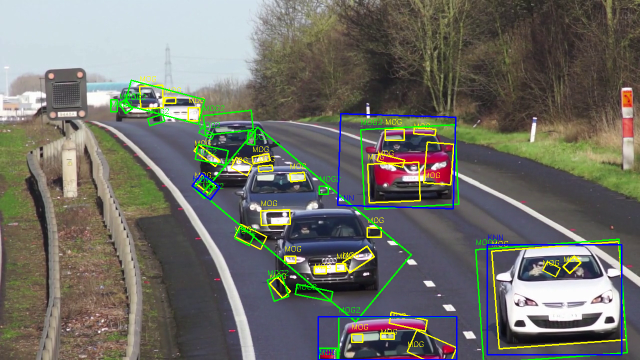

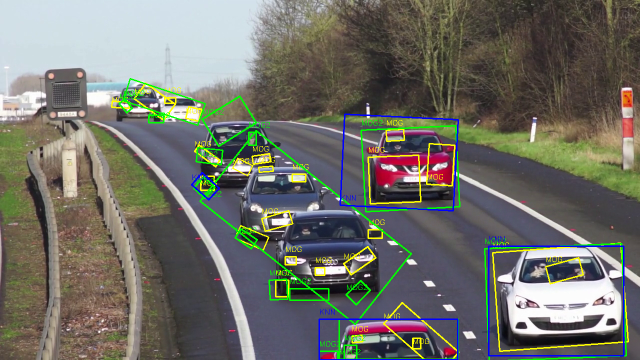

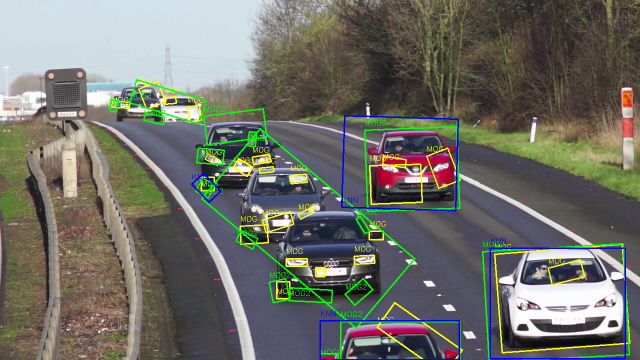

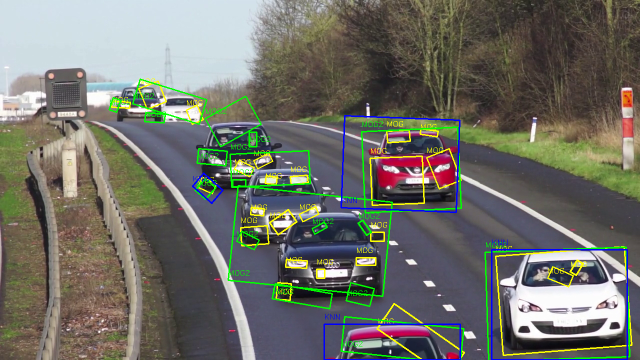

Buffered data was truncated after reaching the output size limit.

In [7]:
process_video('videos/Cars.mp4')

In [8]:
def run_single_method(method_name, input_path):
    cap = cv2.VideoCapture(input_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)

    output_path = f"{method_name}_output.mp4"
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    # Initialize only the selected background subtractor
    if method_name == 'MOG':
        subtractor = cv2.bgsegm.createBackgroundSubtractorMOG(history=200,
                                                              nmixtures=5)
        color = (0, 255, 255)  # Yellow
    elif method_name == 'MOG2':
        subtractor = cv2.createBackgroundSubtractorMOG2(history=500,
                                                        detectShadows=False)
        color = (0, 255, 0)  # Green
    elif method_name == 'KNN':
        subtractor = cv2.createBackgroundSubtractorKNN(history=500,
                                                       dist2Threshold=400)
        color = (255, 0, 0)  # Blue
    else:
        print(f"Unsupported method: {method_name}")
        return

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        result_frame = frame.copy()
        fgmask = subtractor.apply(frame)
        fgmask = apply_morphological_filters(fgmask)
        boxes = detect_objects(fgmask)

        for box in boxes:
            cv2.drawContours(result_frame, [box], 0, color, 2)
            cv2.putText(result_frame, method_name, (box[0][0], box[0][1]-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

        out.write(result_frame)

    cap.release()
    out.release()

    if os.path.exists(output_path):
        print(f"{method_name} result saved.")
        files.download(output_path)
    else:
        print(f"Failed to save {method_name} output.")

In [9]:
video_path = 'videos/Cars.mp4'
run_single_method('MOG', video_path)
run_single_method('MOG2', video_path)
run_single_method('KNN', video_path)

MOG result saved.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

MOG2 result saved.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

KNN result saved.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>